In [ ]:
!pip install itables missingno

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 58.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 55.3 MB/s eta 0:00:00


In [1]:
import pandas as pd
import numpy as np

import missingno as msno
import matplotlib.pyplot as plt
import seaborn as sns

import itables
from itables import show

In [2]:
# Загрузка данных
original_data = pd.read_excel('Данные_для_курсовои_Классическое_МО.xlsx')

In [3]:
# Копирование, чтобы не перезагружать данные из файла
data = original_data.copy()
show(data.head(3))

In [ ]:
# Смотрим тип данных и пропуски
cols = data.columns.tolist()

chunk_size = 20
for i in range(0, len(cols), chunk_size):
    print(data[cols[i:i + chunk_size]].info())
    print('-' * 60)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1001 entries, 0 to 1000
Data columns (total 20 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   Unnamed: 0           1001 non-null   int64  
 1   IC50, mM             1001 non-null   float64
 2   CC50, mM             1001 non-null   float64
 3   SI                   1001 non-null   float64
 4   MaxAbsEStateIndex    1001 non-null   float64
 5   MaxEStateIndex       1001 non-null   float64
 6   MinAbsEStateIndex    1001 non-null   float64
 7   MinEStateIndex       1001 non-null   float64
 8   qed                  1001 non-null   float64
 9   SPS                  1001 non-null   float64
 10  MolWt                1001 non-null   float64
 11  HeavyAtomMolWt       1001 non-null   float64
 12  ExactMolWt           1001 non-null   float64
 13  NumValenceElectrons  1001 non-null   int64  
 14  NumRadicalElectrons  1001 non-null   int64  
 15  MaxPartialCharge     998 non-null    f

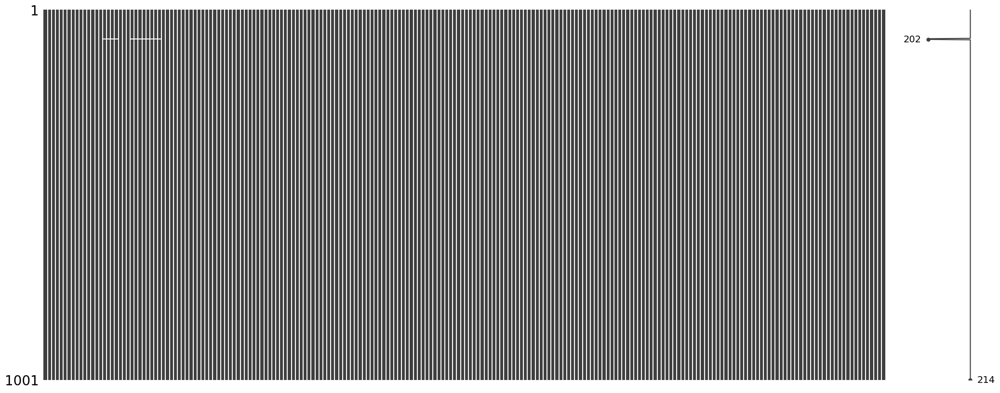

In [ ]:
# Визуализируем пропуски
msno.matrix(data)
plt.show()

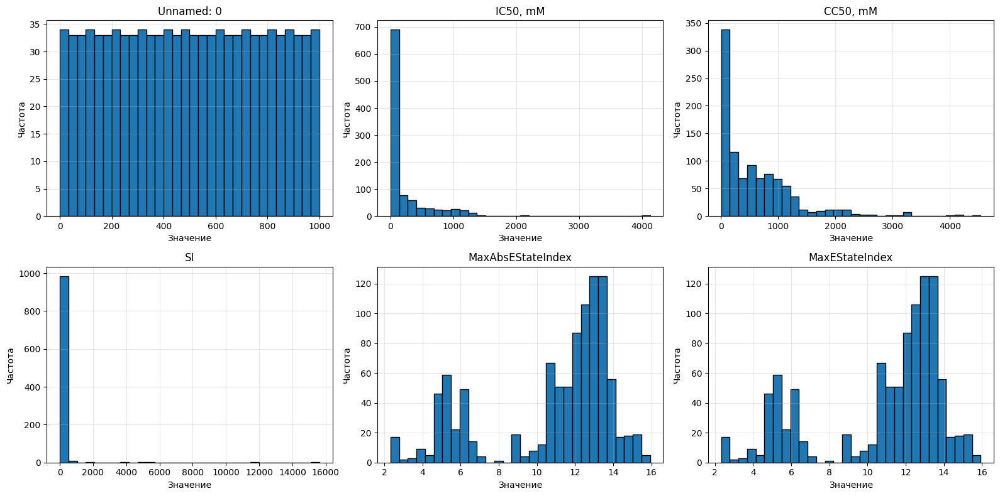

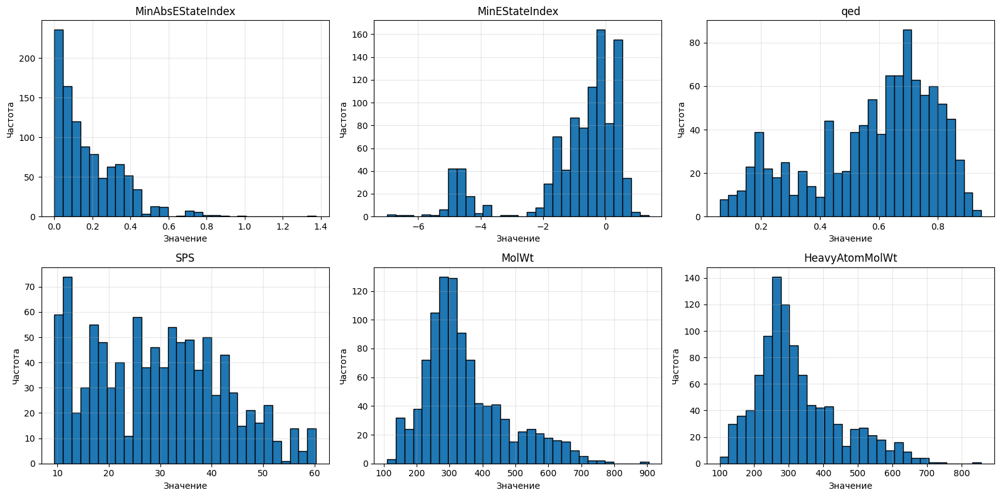

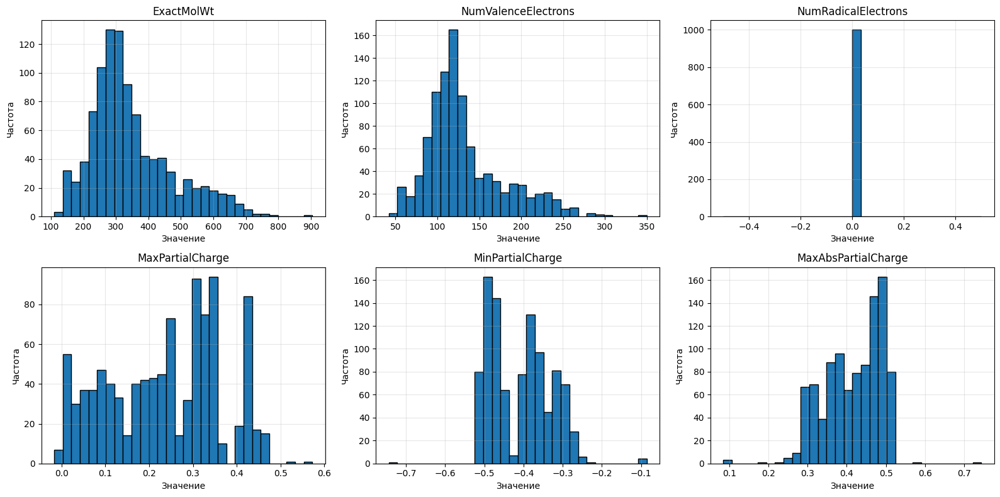

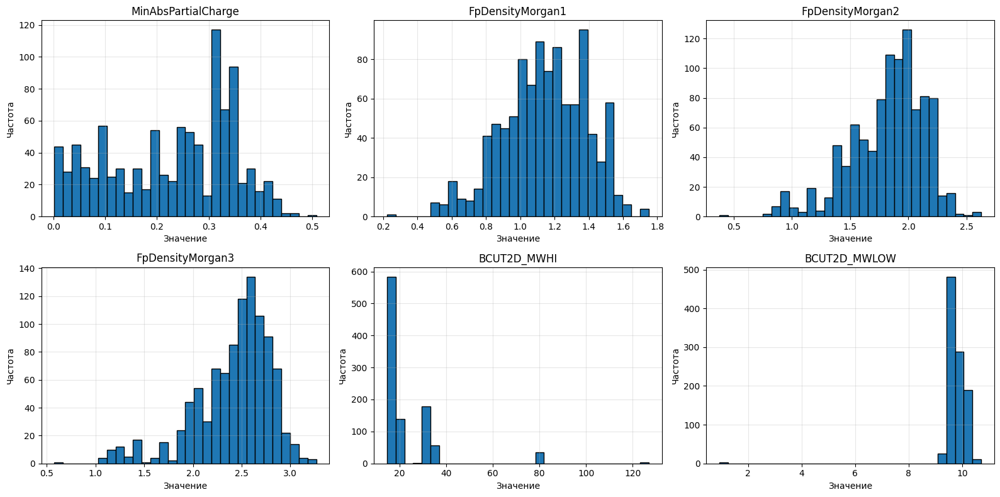

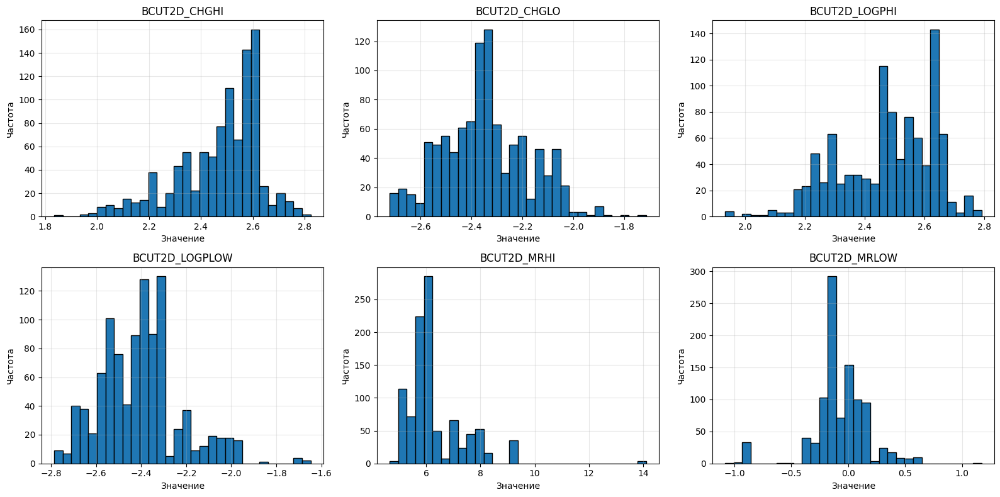

...

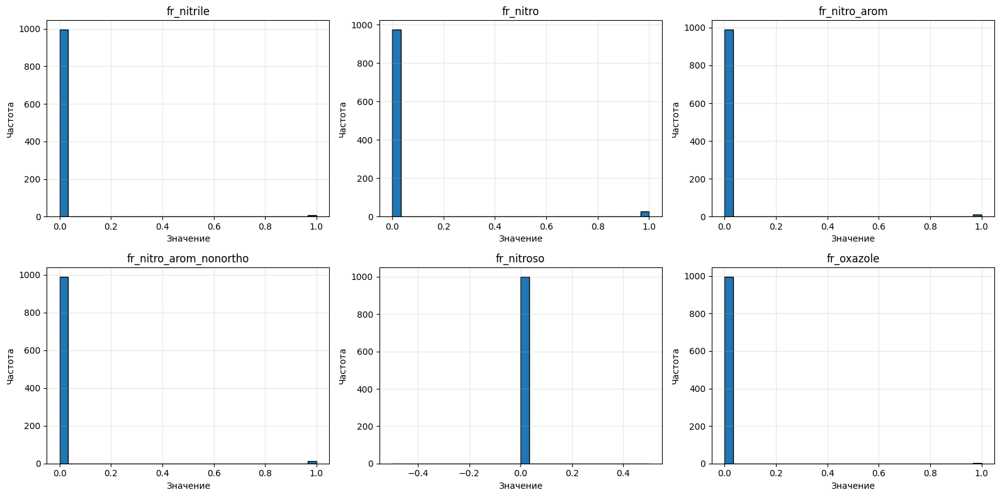

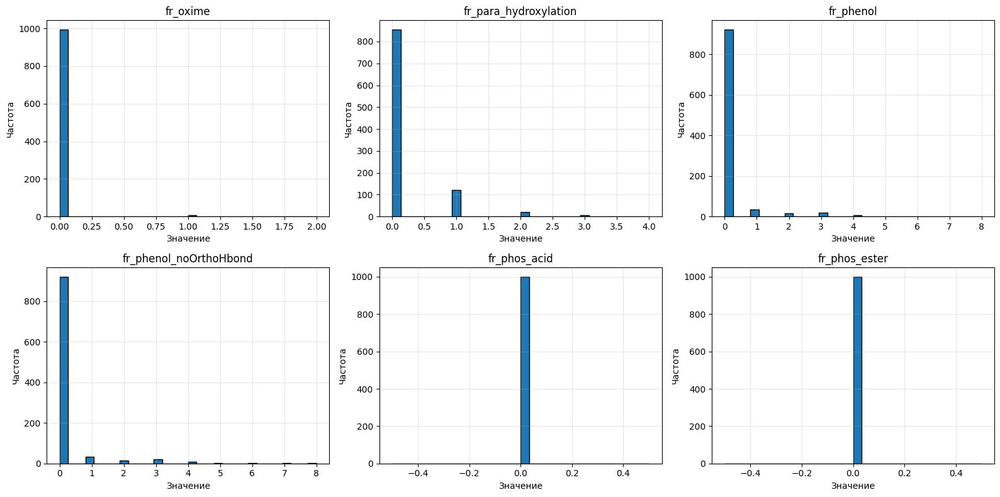

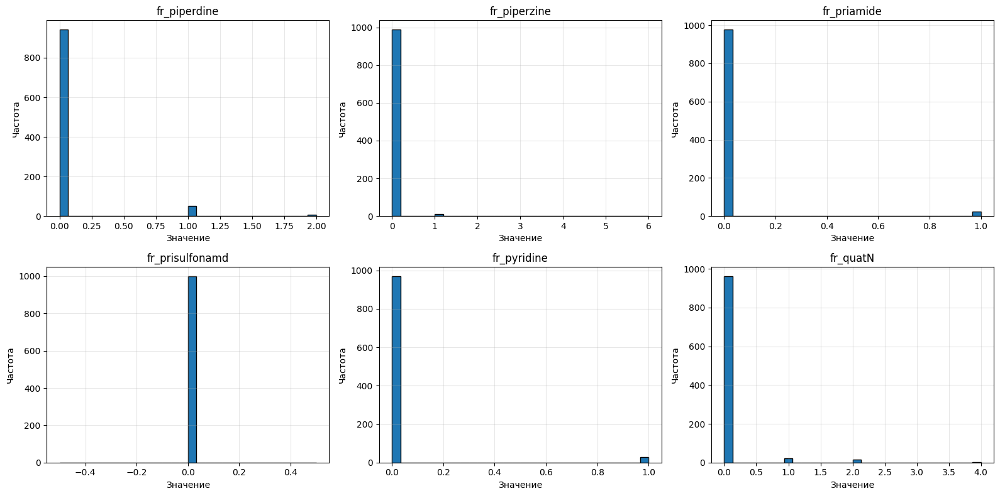

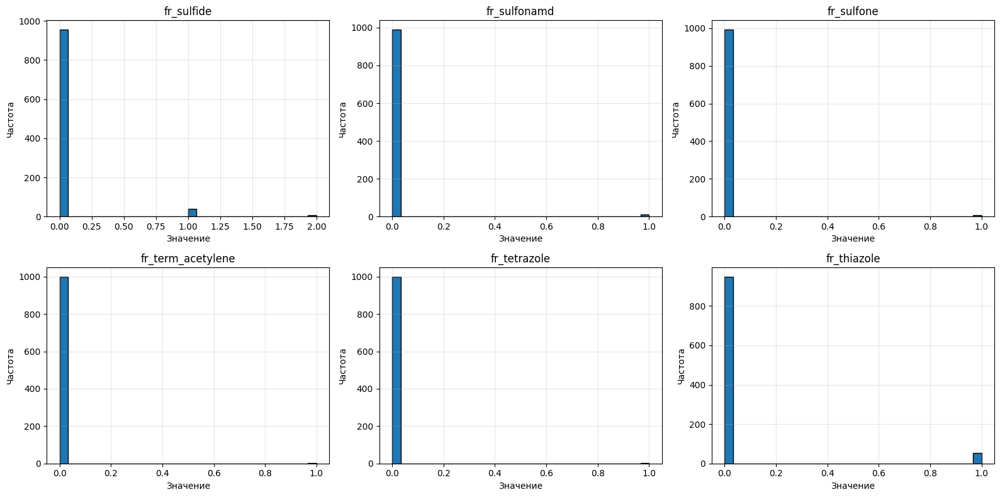

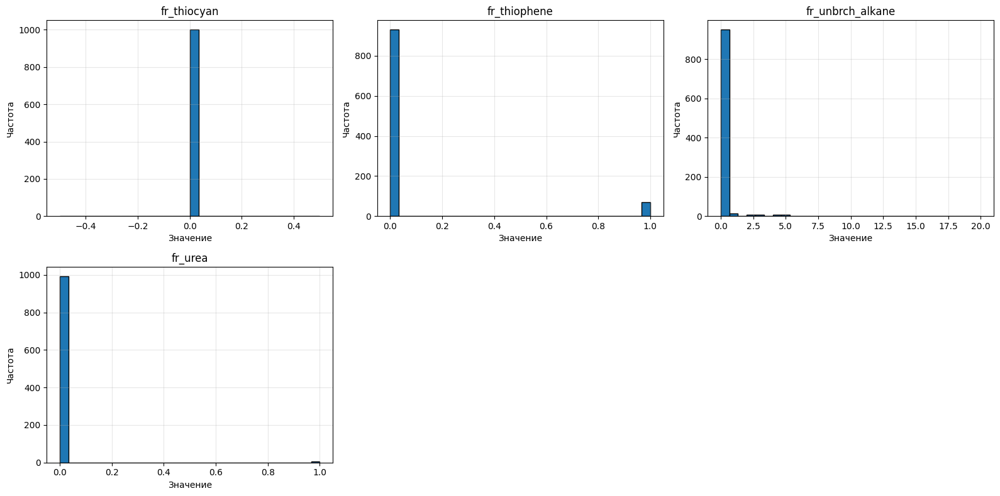

In [ ]:
# Смотрим на распределение данных у разных колонок
numeric_cols = data.select_dtypes(include=['number']).columns
cols_per_row = 3  # количество графиков в одной строке
n_cols = len(numeric_cols)
n_rows = (n_cols // cols_per_row) + (1 if n_cols % cols_per_row > 0 else 0)

for i in range(0, n_cols, cols_per_row * 2):
    subset = numeric_cols[i:i + cols_per_row * 2]

    fig, axes = plt.subplots(nrows=2, ncols=cols_per_row, figsize=(16, 8))
    axes = axes.flatten()

    for ax, col in zip(axes, subset):
        data[col].hist(ax=ax, bins=30, edgecolor='black')
        ax.set_title(f'{col}')
        ax.set_xlabel('Значение')
        ax.set_ylabel('Частота')
        ax.grid(True, alpha=0.3)

    # Скрыть лишние оси, если не хватает графиков
    for j in range(len(subset), len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

На основе распределения уже становится понятно, что некоторые колонки можно выкинуть из-за их неинформативности.

Колонка Unnamed: 0 является индексом и не несет в себе информацию. Следующие колонки содержат одно значение и никакое более, поэтому тоже не представляют для нас интереса: NumRadicalElectrons, SMR_VSA8, SlogP_VSA9, fr_Ar_COO, fr_N_O, fr_SH, fr_azide, fr_barbitur, fr_benzodiazepine, fr_diazo, fr_dihydropyridine, fr_isocyan, fr_isothiocyan, fr_lactam, fr_nitroso, fr_phos_acid, fr_phos_ester, fr_prisulfonamd и другие фрактальные колонки.

Очень несбаланисрованное распределение данных (т.е. на гистограмме, похоже, более 95% значений - какое-то конкретное значение) наблюдается у следующих колонок - Ipc, SMR_VSA2, SlogP_VSA7, EState_VSA11, fr_Al_COO, fr_ArN, fr_Ar_NH, fr_COO, fr_COO2, fr_C_S, fr_HOCCN, fr_Ndealkylation1, fr_Ndealkylation2, fr_Nhpyrrole, fr_aldehyde, fr_alkyl_carbamate, fr_amidine, fr_azo, fr_epoxide, fr_furan, fr_guanido, fr_hdrzine, fr_hdrzone, fr_imidazole, fr_imide, fr_lactone, fr_morpholine, fr_nitrile, fr_nitro, fr_nitro_arom, fr_nitro_arom_nonortho, fr_oxazole, fr_oxime, fr_piperdine, fr_piperzine, fr_priamide, fr_pyridine, fr_quatN, fr_sulfide, fr_sulfonamd, fr_sulfone, fr_term_acetylene, fr_term_acetylene и другие фрактальные колонки.

Ниже я проверю их распределение, и если 1 будет меньше, чем 2% на весь датасет, то эти колонки я удалю. А также проверю колонки, в которых обнаружила по гистограмме лишь одно значение, чтобы это подтвердить (вдруг не было заммечено, что столбцов на гистограмме больше).

In [ ]:
# массив колонок с единственным значением (пойдут на удаление)
cols_with_one_value = []

# массив колонок, где доминирует одно значение (больше 98%)
cols_with_bad_distribution = []

In [ ]:
data['NumRadicalElectrons'].value_counts()

,count
NumRadicalElectrons,
0,1001


In [ ]:
cols_with_one_value.append('NumRadicalElectrons')

In [ ]:
data['SMR_VSA8'].value_counts()

,count
SMR_VSA8,
0,1001


In [ ]:
cols_with_one_value.append('SMR_VSA8')

In [ ]:
data['SlogP_VSA9'].value_counts()

,count
SlogP_VSA9,
0,1001


In [ ]:
cols_with_one_value.append('SlogP_VSA9')

In [ ]:
data['Ipc'].value_counts()

,count
Ipc,
9.343961e+03,19
5.353453e+04,17
4.343558e+02,12
1.242959e+03,11
1.906764e+04,10
...,...
6.485017e+11,1
3.383716e+10,1
1.226981e+07,1


In [ ]:
data['SMR_VSA2'].value_counts()

,count
SMR_VSA2,
0.000000,990
5.261892,6
5.409284,2
5.402308,2
5.531129,1


In [ ]:
990/1001

0.989010989010989

In [ ]:
cols_with_bad_distribution.append('SMR_VSA2')

Проверим все дескрипторы фрагментов.

In [ ]:
fr_cols = [col for col in data.columns if 'fr' in col]

In [ ]:
for col in fr_cols:
  temp = data[col].value_counts()
  if temp.shape[0] == 1:
    cols_with_one_value.append(col)
  elif temp.shape[0] == 2:
    if temp[0] / data.shape[0] > 0.98:
      cols_with_bad_distribution.append(col)

In [ ]:
cols_with_one_value

['NumRadicalElectrons',
 'SMR_VSA8',
 'SlogP_VSA9',
 'fr_N_O',
 'fr_SH',
 'fr_azide',
 'fr_barbitur',
 'fr_benzodiazepine',
 'fr_diazo',
 'fr_dihydropyridine',
 'fr_isocyan',
 'fr_isothiocyan',
 'fr_lactam',
 'fr_nitroso',
 'fr_phos_acid',
 'fr_phos_ester',
 'fr_prisulfonamd',
 'fr_thiocyan']

In [ ]:
cols_with_bad_distribution

['fr_Ar_COO',
 'fr_HOCCN',
 'fr_aldehyde',
 'fr_alkyl_carbamate',
 'fr_amidine',
 'fr_azo',
 'fr_guanido',
 'fr_hdrzine',
 'fr_nitrile',
 'fr_nitro_arom',
 'fr_nitro_arom_nonortho',
 'fr_oxazole',
 'fr_sulfonamd',
 'fr_sulfone',
 'fr_term_acetylene',
 'fr_tetrazole',
 'fr_urea']

In [ ]:
# Удаляем колонки с одним значением, либо где одно значение занимает больше 98%
data.drop(columns=cols_with_one_value + cols_with_bad_distribution, axis=1, inplace=True)

In [ ]:
# Убираем неинформативную колонку
data.drop(columns=['Unnamed: 0'], axis=1, inplace=True)

In [ ]:
data.describe()

,"IC50, mM","CC50, mM",SI,MaxAbsEStateIndex,MaxEStateIndex,MinAbsEStateIndex,MinEStateIndex,qed,SPS,MolWt,...,fr_phenol_noOrthoHbond,fr_piperdine,fr_piperzine,fr_priamide,fr_pyridine,fr_quatN,fr_sulfide,fr_thiazole,fr_thiophene,fr_unbrch_alkane
count,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000,...,1001.000000,1001.000000,1001.000000,1001.000000,1001.00000,1001.000000,1001.000000,1001.000000,1001.000000,1001.000000
mean,222.805156,589.110728,72.508823,10.831637,10.831637,0.180681,-0.967237,0.580412,29.487989,348.262234,...,0.177822,0.064935,0.017982,0.023976,0.02997,0.054945,0.053946,0.051948,0.069930,0.204795
std,402.169734,642.867508,684.482739,3.307505,3.307505,0.168710,1.588036,0.212230,12.742749,126.946370,...,0.726875,0.269776,0.218349,0.153051,0.17059,0.303279,0.259011,0.222033,0.255157,1.215326
min,0.003517,0.700808,0.011489,2.321942,2.321942,0.000039,-6.992796,0.059567,9.416667,110.156000,...,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,12.515396,99.999036,1.433333,9.252350,9.252350,0.051073,-1.334487,0.442842,18.486486,264.321000,...,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,46.585183,411.039342,3.846154,12.179236,12.179236,0.124606,-0.419485,0.634981,29.290323,315.457000,...,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,224.975928,894.089176,16.566667,13.167843,13.167843,0.291020,0.061754,0.742483,38.750000,409.283000,...,0.000000,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.000000,0.000000,0.000000
max,4128.529377,4538.976189,15620.600000,15.933463,15.933463,1.374614,1.374614,0.947265,60.272727,904.777000,...,8.000000,2.000000,6.000000,1.000000,1.00000,4.000000,2.000000,1.000000,1.000000,20.000000


Удаляем пропуски (коих совсем немного, поэтому мы сильно ничего не теряем, а заполнять какими-то статистическими значениями я бы не рисковала).

In [ ]:
data = data.dropna()

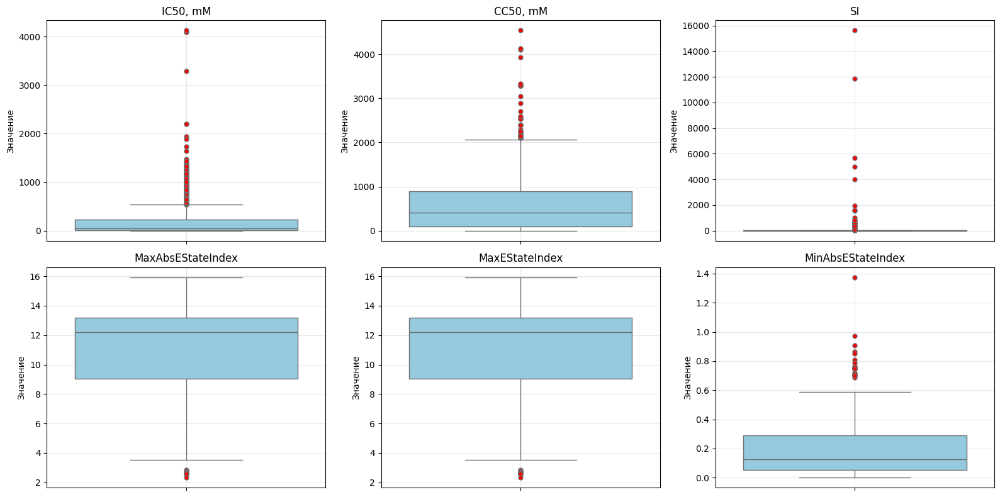

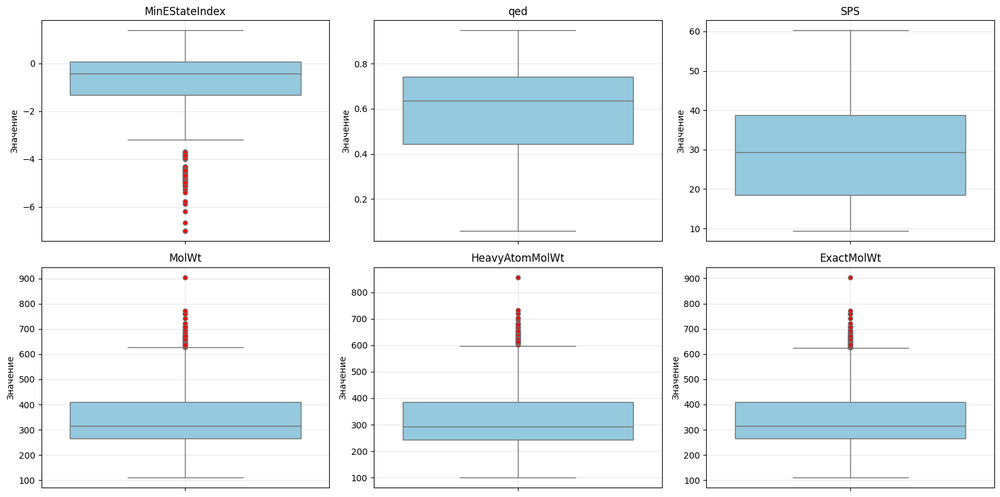

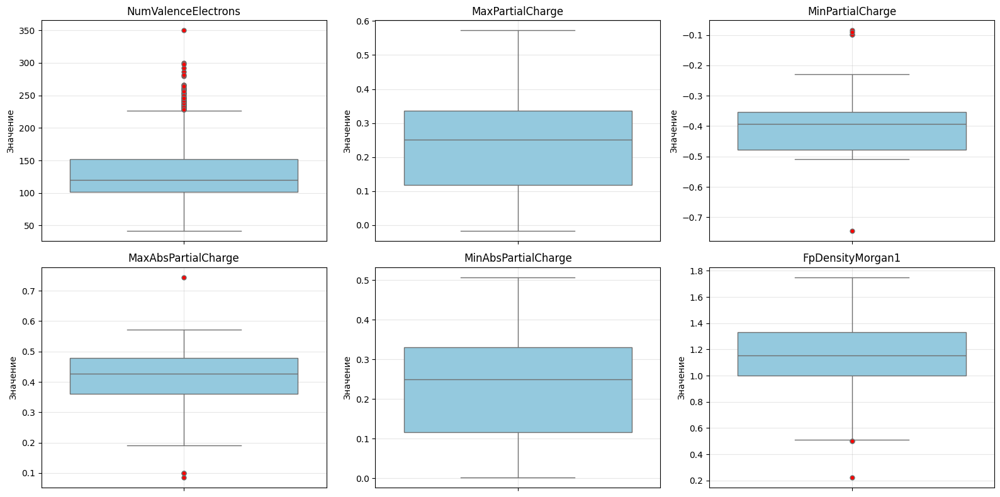

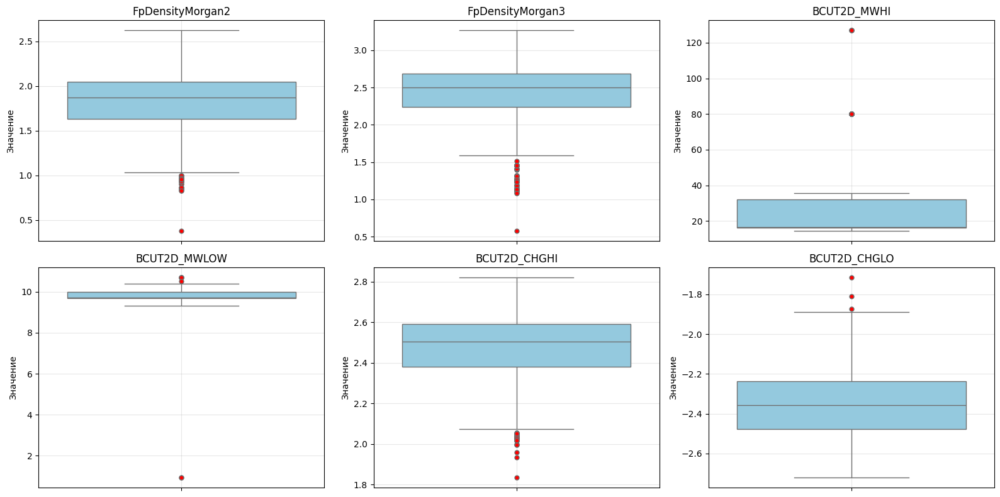

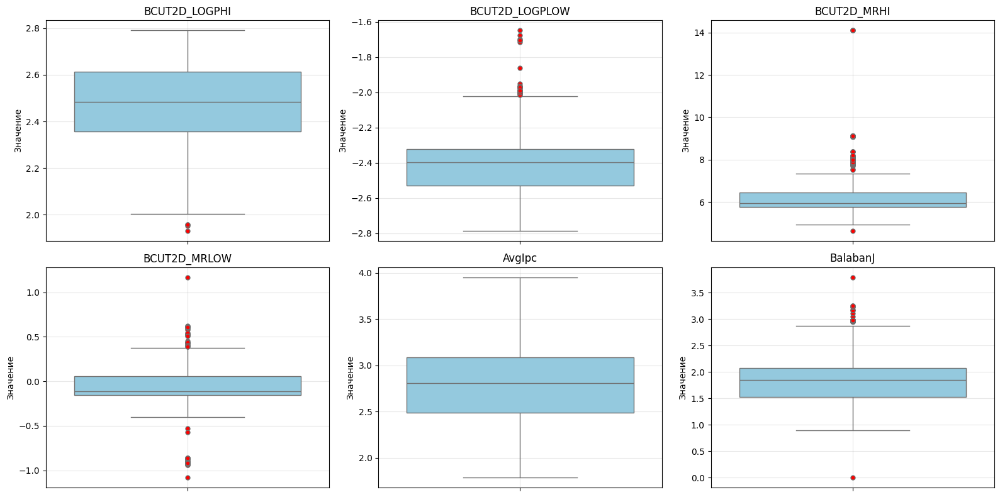

...

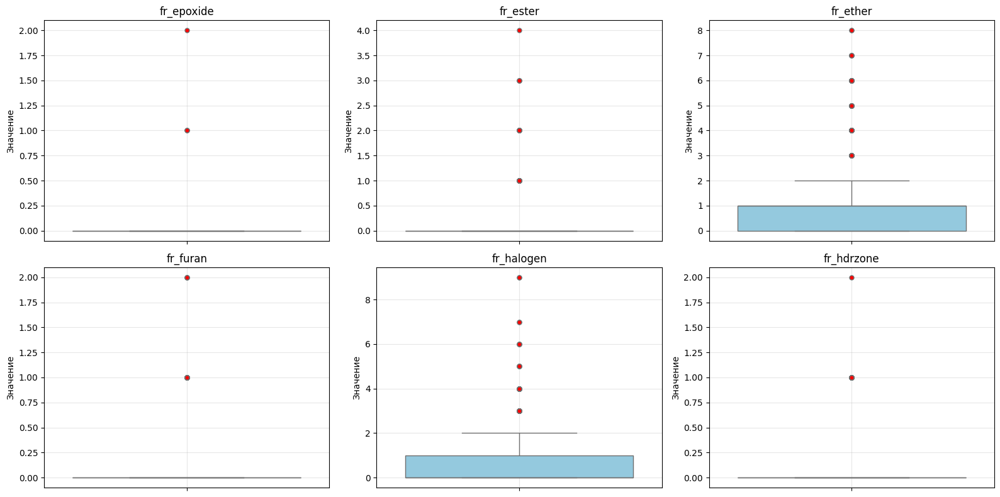

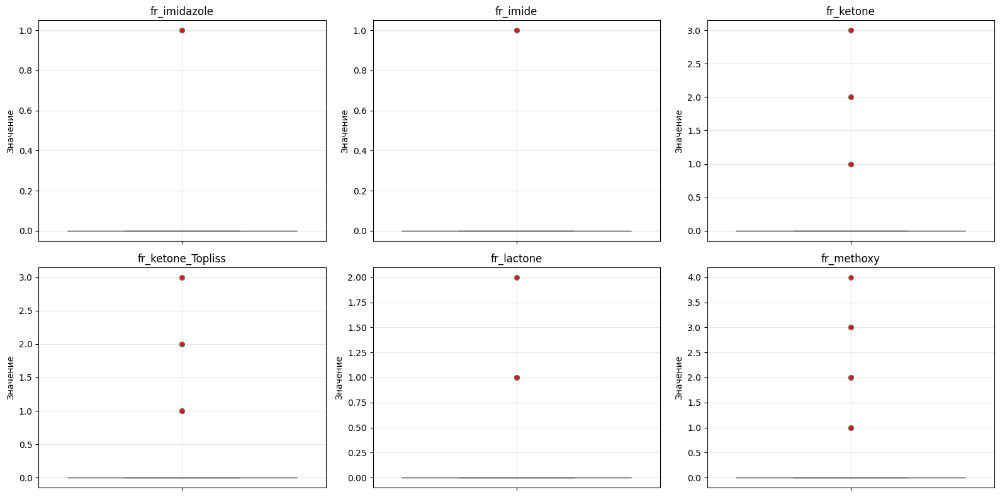

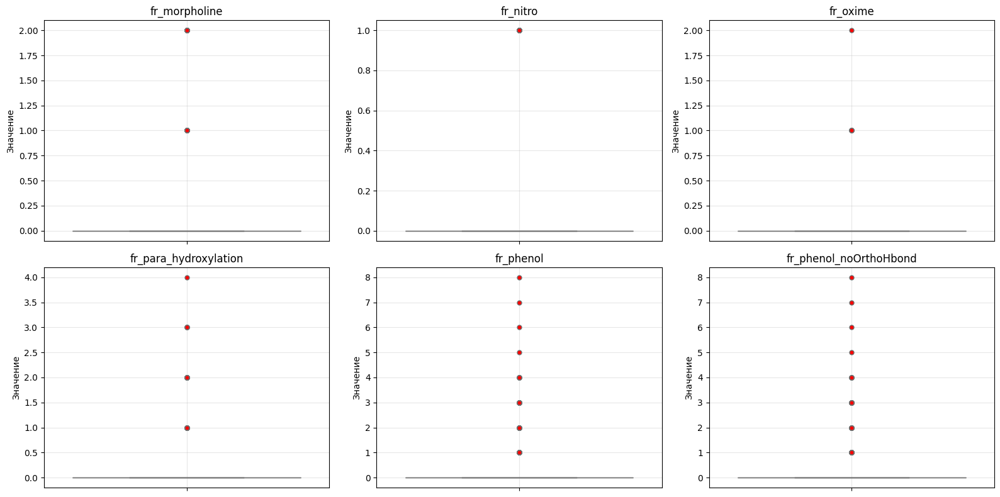

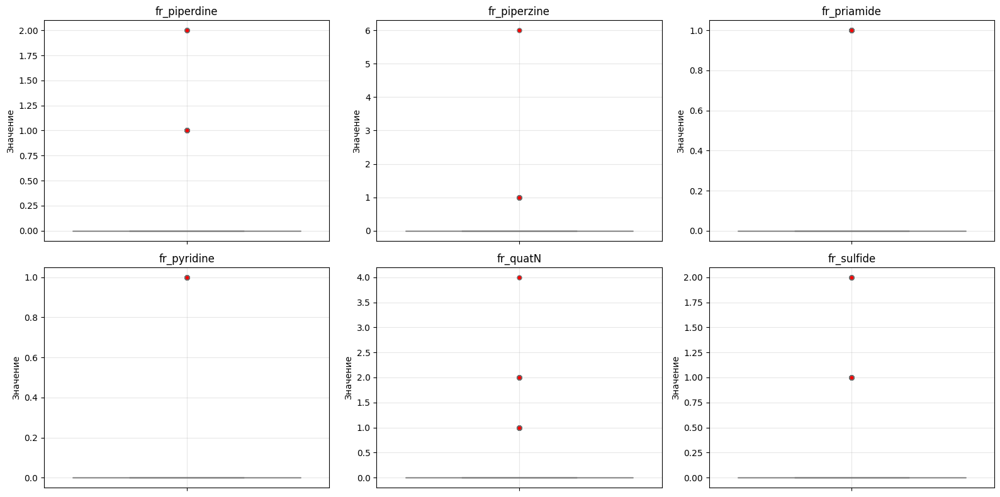

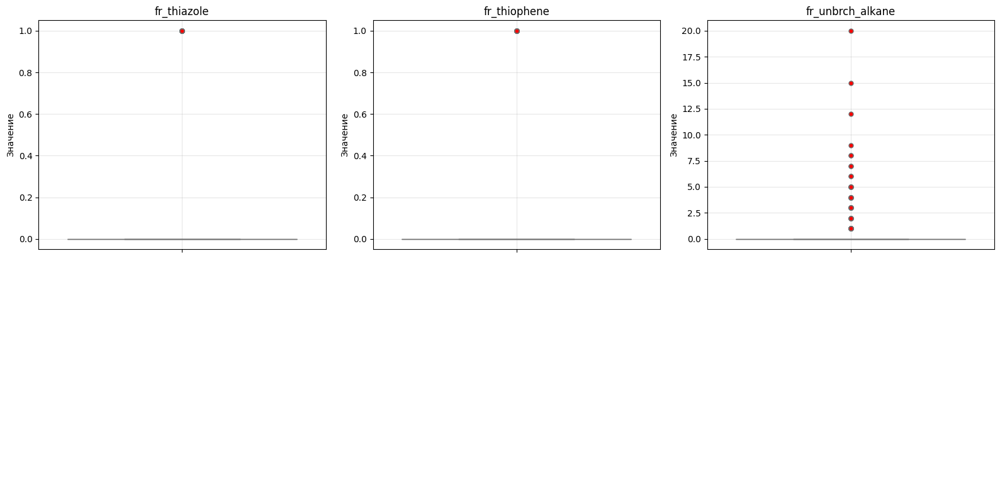

In [ ]:
# Смотрим выбросы
numeric_cols = data.select_dtypes(include=['number']).columns
cols_per_row = 3  # количество графиков в одной строке
n_cols = len(numeric_cols)
n_rows = (n_cols // cols_per_row) + (1 if n_cols % cols_per_row > 0 else 0)

for i in range(0, n_cols, cols_per_row * 2):
    subset = numeric_cols[i:i + cols_per_row * 2]

    fig, axes = plt.subplots(nrows=2, ncols=cols_per_row, figsize=(16, 8))
    axes = axes.flatten()

    for ax, col in zip(axes, subset):
        # Используем seaborn.boxplot или matplotlib
        sns.boxplot(y=data[col], ax=ax, color='skyblue', flierprops=dict(markerfacecolor='r', markersize=5))
        ax.set_title(f'{col}')
        ax.set_ylabel('Значение')
        ax.grid(True, alpha=0.3)

    # Скрыть лишние оси, если не хватает графиков
    for j in range(len(subset), len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

In [ ]:
# Удаляем дубликаты
data = data.drop_duplicates()

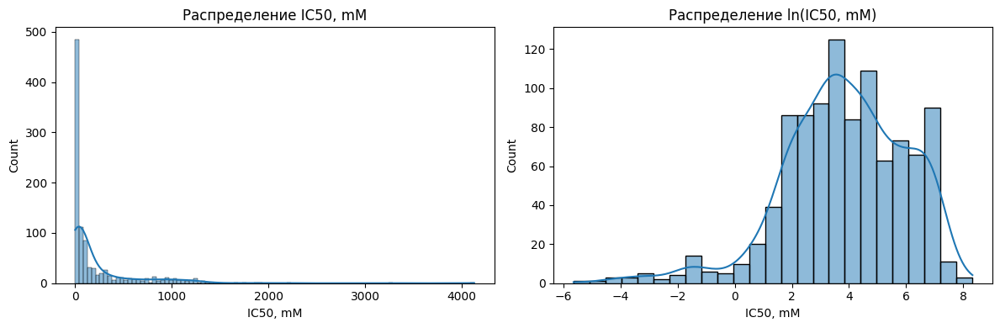

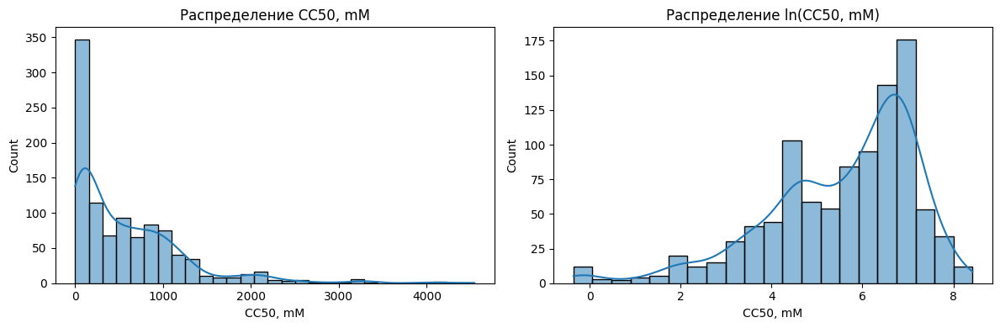

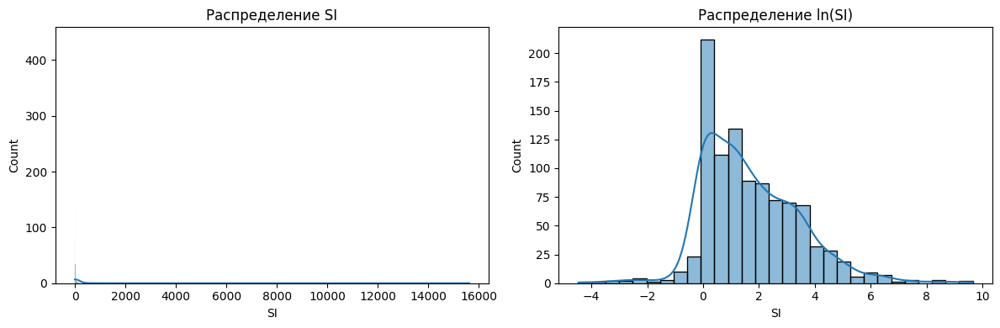

In [ ]:
# Сравниваем распределение значений целевых с логарифмированием и без
targets = ['IC50, mM', 'CC50, mM', 'SI']
for target in targets:
    plt.figure(figsize=(12, 4))

    plt.subplot(1, 2, 1)
    sns.histplot(data[target], kde=True)
    plt.title(f'Распределение {target}')

    plt.subplot(1, 2, 2)
    sns.histplot(np.log(data[target]), kde=True)
    plt.title(f'Распределение ln({target})')

    plt.tight_layout()
    plt.show()

Логарифмирование целевых улучшает распределение, будем это учитывать при дальнейших наших решениях.

Посмотрим на высоко коррелирующие пары, чтобы понять их зависимость.

In [ ]:
corr_matrix = data.corr().abs()
upper_triangle = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))
numpy_triangle = np.array(upper_triangle)
cols = upper_triangle.columns
threshold = 0.8
correlated_pairs = []
for i in range(numpy_triangle.shape[0]):
  for j in range(numpy_triangle.shape[1]):
    if (numpy_triangle[i][j] > threshold) and (i != j):
      correlated_pairs.append((cols[i], cols[j]))

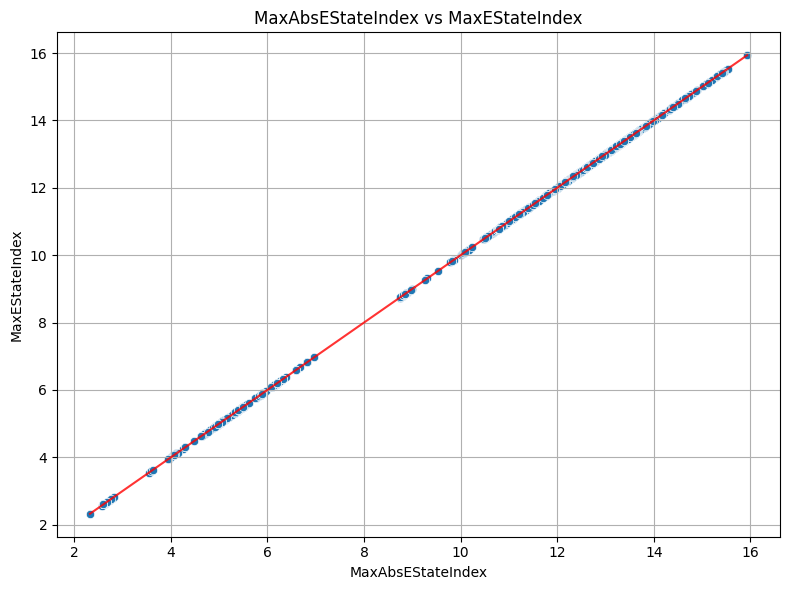

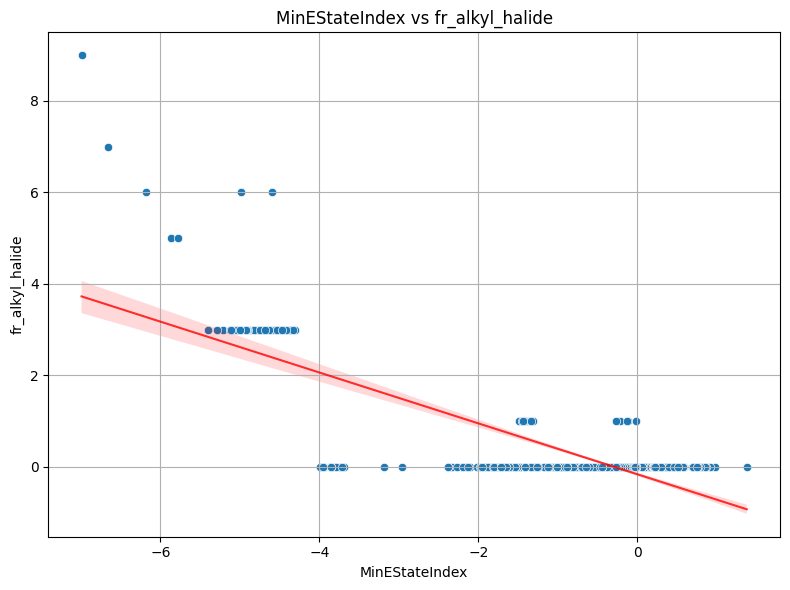

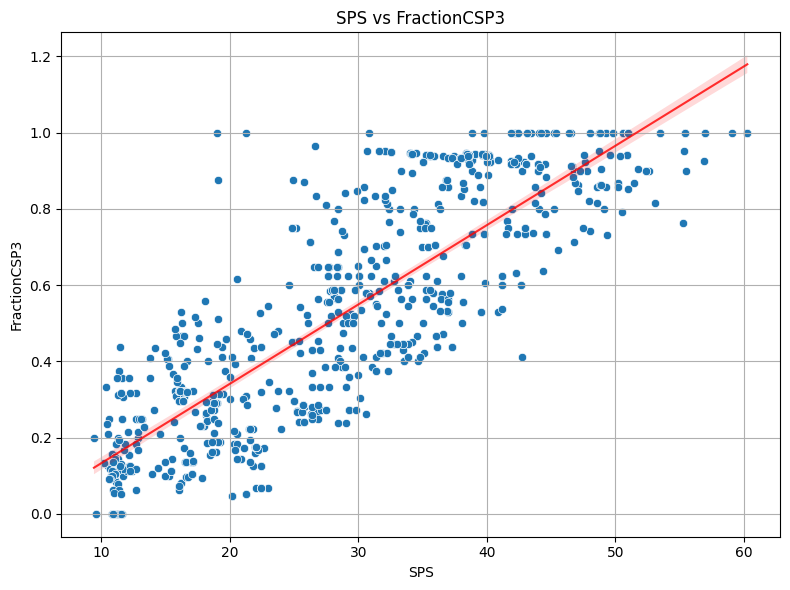

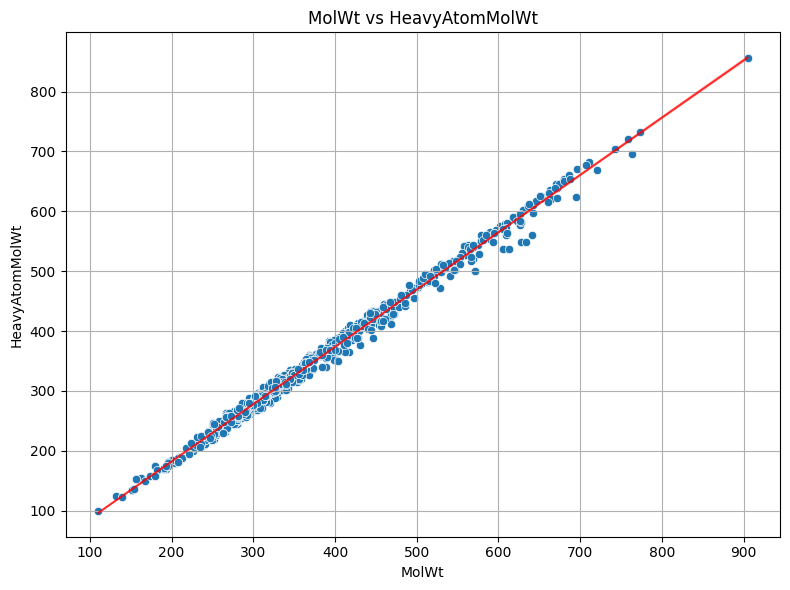

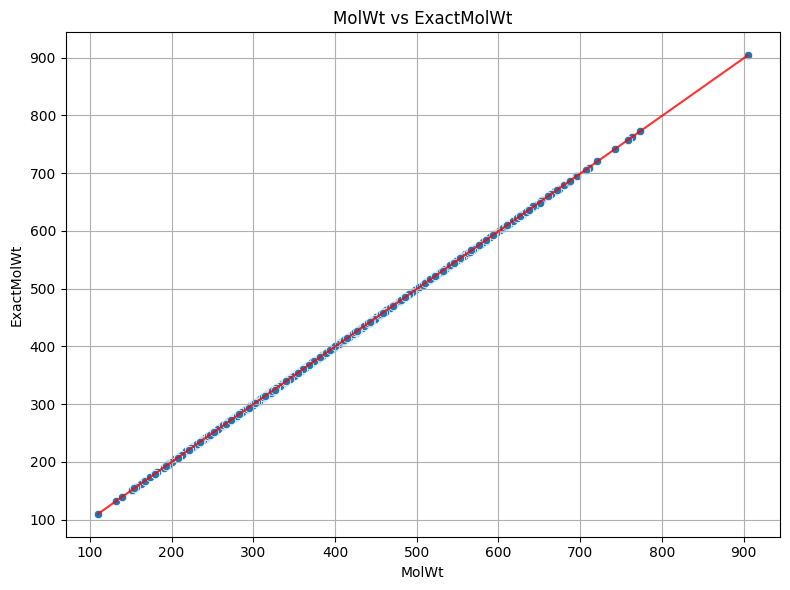

...

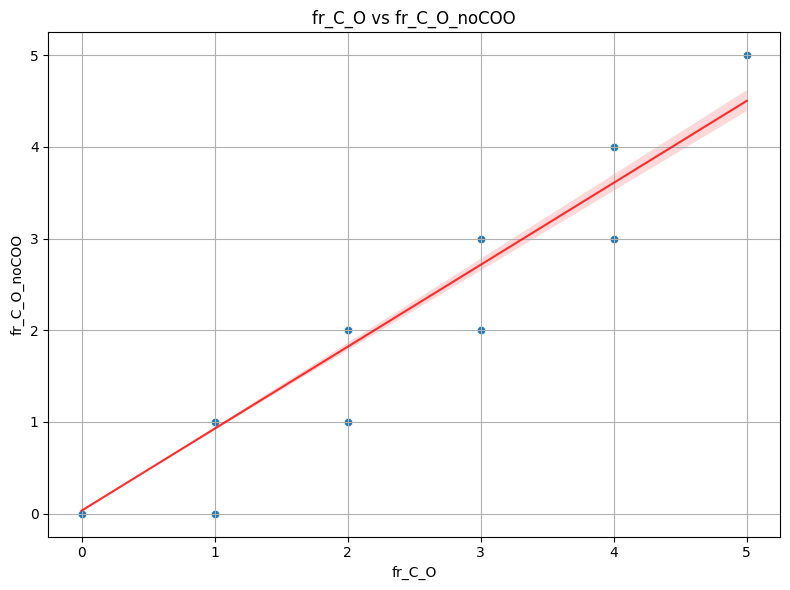

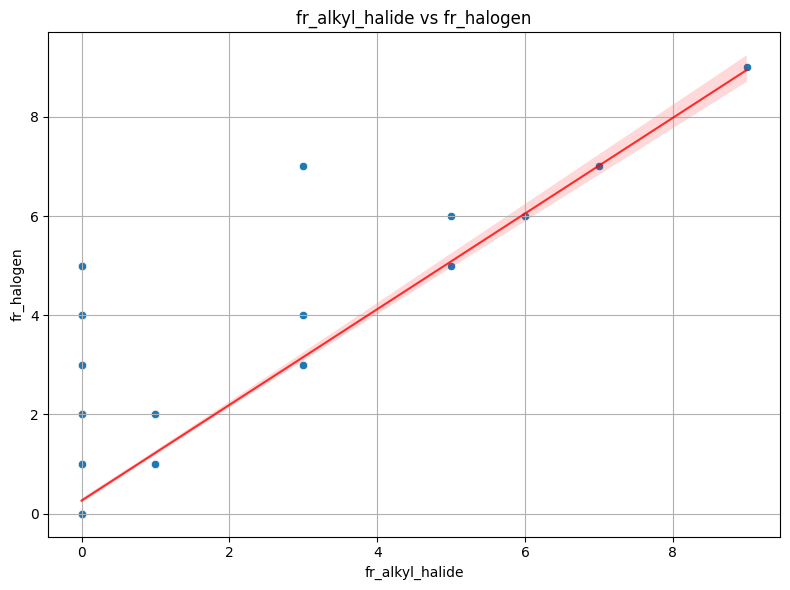

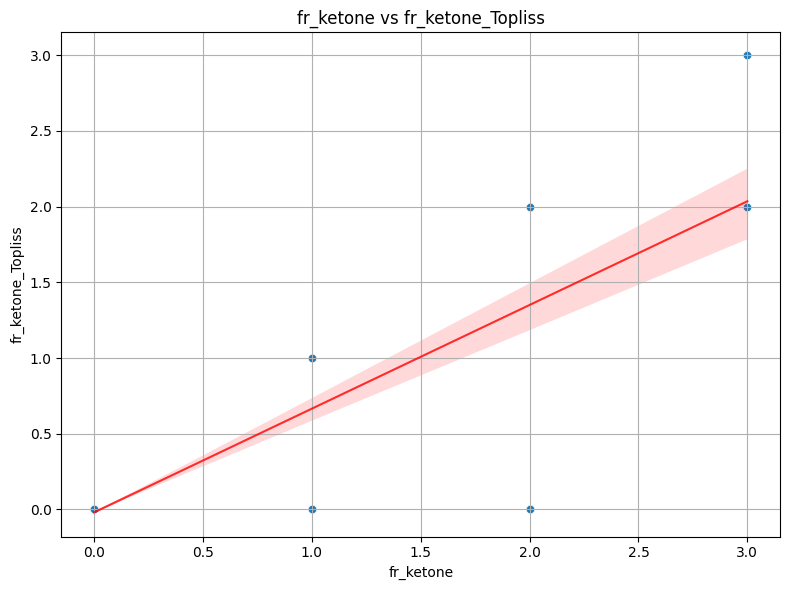

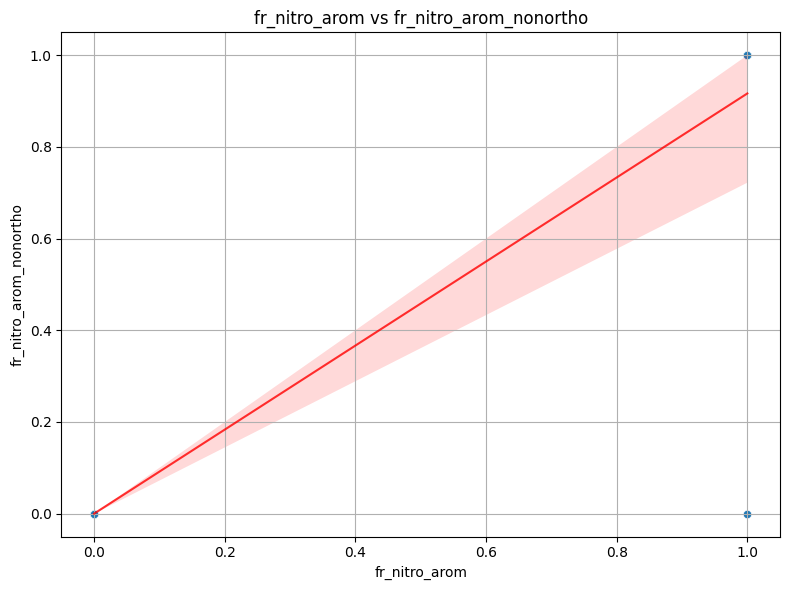

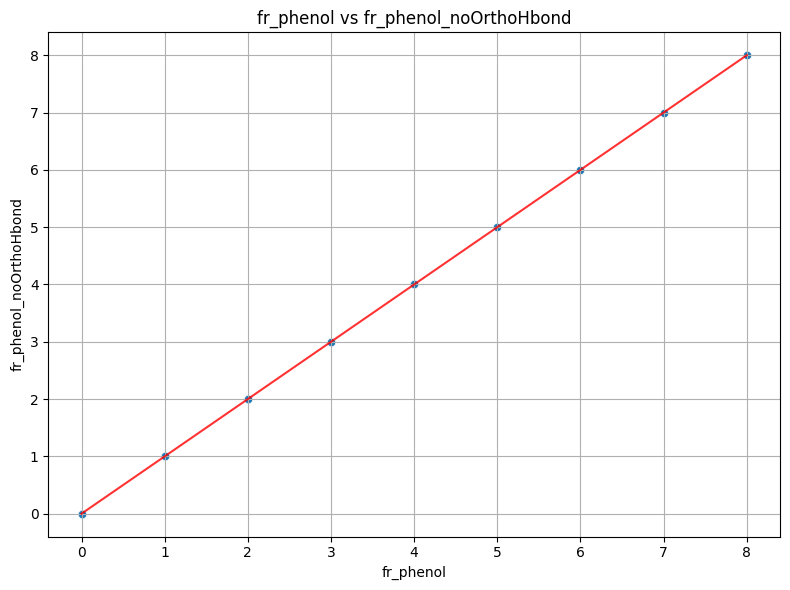

In [ ]:
def plot_pair_with_trend(x, y, df):
    plt.figure(figsize=(8, 6))
    sns.scatterplot(x=df[x], y=df[y])
    sns.regplot(x=df[x], y=df[y], scatter=False, color='red', line_kws={"lw":1.5, "alpha":0.8})
    plt.title(f"{x} vs {y}")
    plt.xlabel(x)
    plt.ylabel(y)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Обработка всех пар
for pair in correlated_pairs:
    x, y = pair
    plot_pair_with_trend(x, y, data)

Теперь посмотрим на корреляцию признаков в целом.

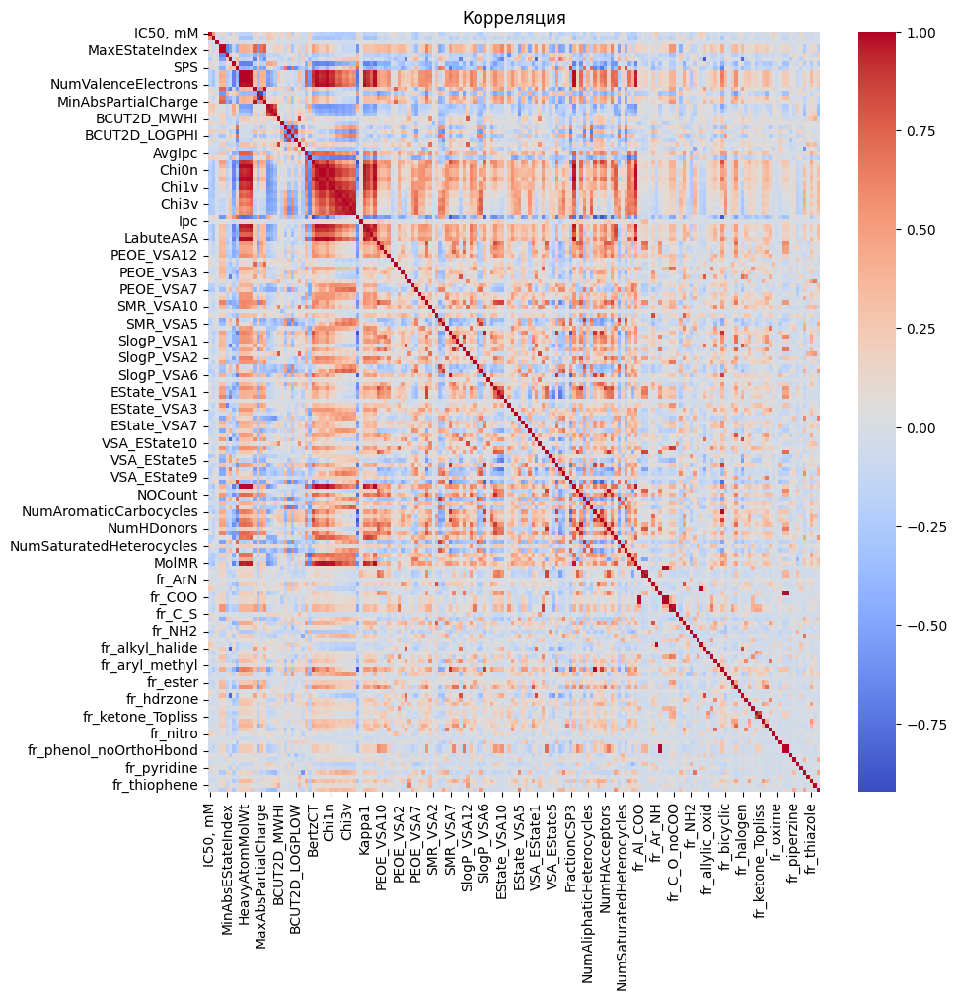

In [ ]:
corr_matrix_general = data.corr()
plt.figure(figsize=(10, 10))
sns.heatmap(corr_matrix_general, annot=False, cmap='coolwarm')
plt.title("Корреляция")
plt.show()

Посмотрим на корреляцию признаков с каждой из целевых.

<ipython-input-31-2013553466>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=correlations.values, y=correlations.index, palette="viridis")


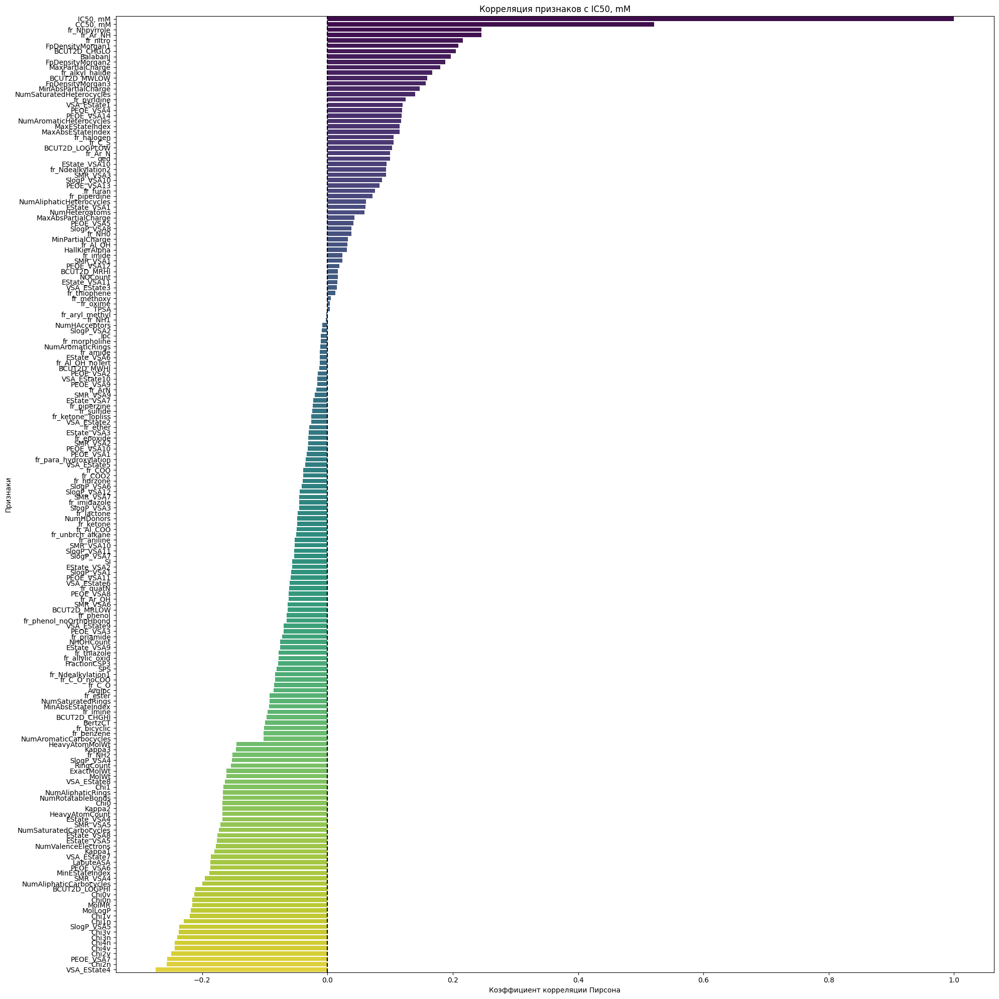

<ipython-input-31-2013553466>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=correlations.values, y=correlations.index, palette="viridis")


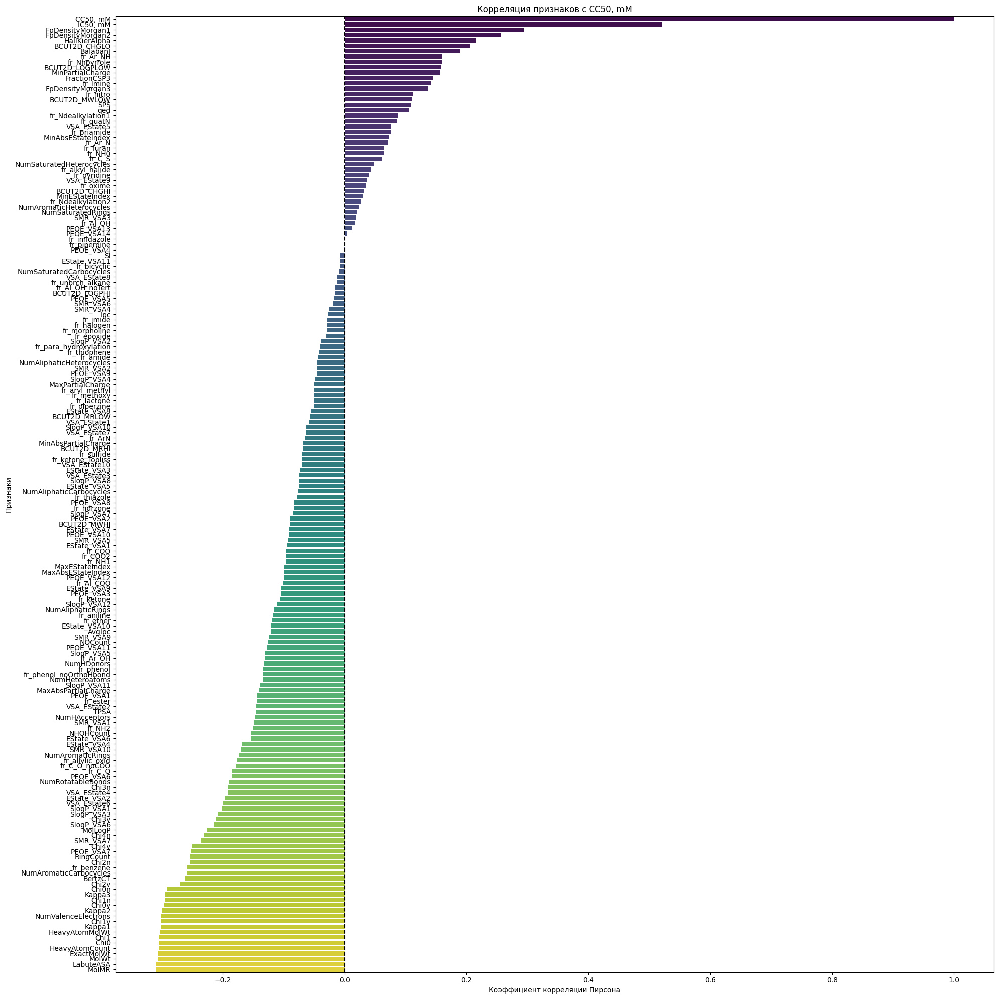

<ipython-input-31-2013553466>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=correlations.values, y=correlations.index, palette="viridis")


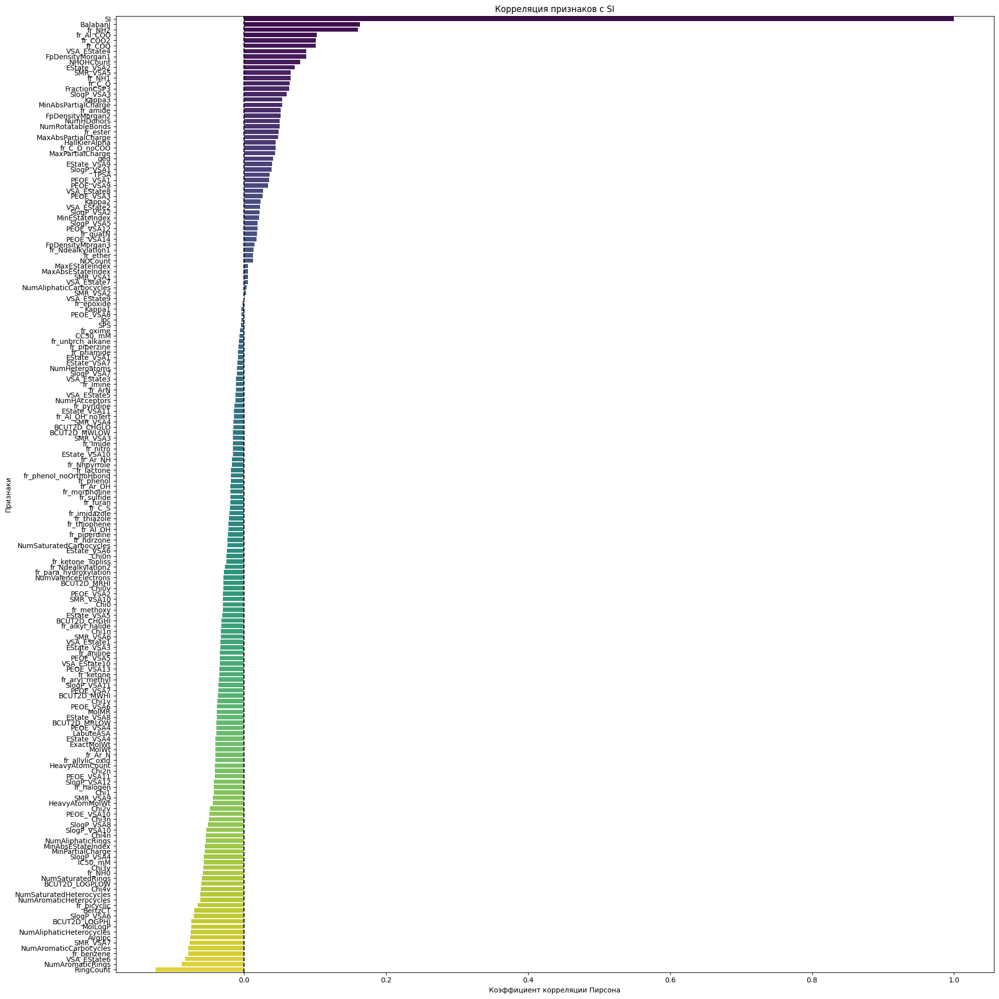

In [ ]:
for i, target in enumerate(targets):
  correlations = data.corr(numeric_only=True)[target].sort_values(ascending=False)

  plt.figure(figsize=(20, 20))
  sns.barplot(x=correlations.values, y=correlations.index, palette="viridis")
  plt.title(f'Корреляция признаков с {target}')
  plt.xlabel('Коэффициент корреляции Пирсона')
  plt.ylabel('Признаки')
  plt.axvline(0, color='black', linestyle='--')  # линия нулевой корреляции
  plt.tight_layout()

  save_path = f'/content/drive/MyDrive/Colab Notebooks/study/data_new/graph_{i}.png'  # укажите нужный путь
  plt.savefig(save_path, dpi=300, bbox_inches='tight')
  plt.show()

Посмотрим на корреляцию между целевыми.

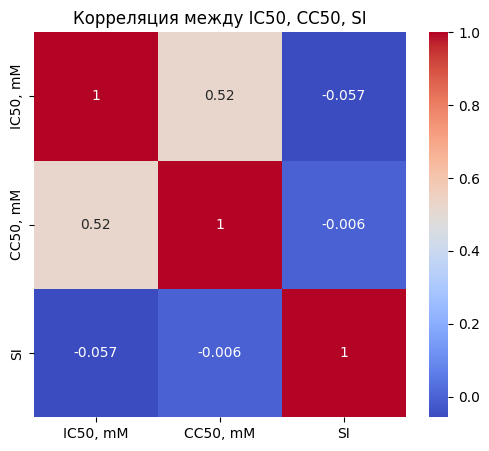

In [ ]:
corr_matrix = data[targets].corr()
plt.figure(figsize=(6, 5))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm')
plt.title("Корреляция между IC50, CC50, SI")
plt.show()

Они напрямую друг от друга не зависят, поэтому допустимо использовать в качестве признака.

Удаляем по одному компоненту из высоко коррелирующих между собой пар (больше 0,9, меньше не берем во избежание утраты информации).

In [ ]:
def remove_high_corr_features(df, threshold=0.9):
    corr_matrix = df.corr().abs()
    upper_triangle = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))

    # Находим столбцы с корреляцией выше порога
    to_drop = [column for column in upper_triangle.columns if any(upper_triangle[column] > threshold)]

    print(f"Признаки для удаления ({len(to_drop)} штук): {to_drop}")

    # Удаляем сильно скоррелированные признаки
    df_reduced = df.drop(columns=to_drop, errors='ignore')

    return df_reduced


df_cleaned = remove_high_corr_features(data.drop(columns=['IC50, mM', 'CC50, mM', 'SI'], axis=1), threshold=0.75)
df_cleaned['IC50, mM'] = data['IC50, mM']
df_cleaned['CC50, mM'] = data['CC50, mM']
df_cleaned['SI'] = data['SI']

Признаки для удаления (80 штук): ['MaxEStateIndex', 'HeavyAtomMolWt', 'ExactMolWt', 'NumValenceElectrons', 'MaxAbsPartialCharge', 'MinAbsPartialCharge', 'FpDensityMorgan2', 'FpDensityMorgan3', 'BCUT2D_LOGPHI', 'BCUT2D_LOGPLOW', 'BCUT2D_MRHI', 'AvgIpc', 'BertzCT', 'Chi0', 'Chi0n', 'Chi0v', 'Chi1', 'Chi1n', 'Chi1v', 'Chi2n', 'Chi2v', 'Chi3n', 'Chi3v', 'Chi4n', 'Chi4v', 'HallKierAlpha', 'Kappa1', 'Kappa2', 'Kappa3', 'LabuteASA', 'SMR_VSA1', 'SMR_VSA7', 'SMR_VSA9', 'SlogP_VSA10', 'SlogP_VSA11', 'SlogP_VSA12', 'SlogP_VSA4', 'SlogP_VSA5', 'SlogP_VSA6', 'TPSA', 'EState_VSA1', 'EState_VSA10', 'VSA_EState1', 'VSA_EState10', 'VSA_EState2', 'VSA_EState3', 'VSA_EState6', 'VSA_EState8', 'FractionCSP3', 'HeavyAtomCount', 'NHOHCount', 'NOCount', 'NumAliphaticCarbocycles', 'NumAliphaticRings', 'NumAromaticCarbocycles', 'NumAromaticRings', 'NumHAcceptors', 'NumHDonors', 'NumHeteroatoms', 'NumRotatableBonds', 'NumSaturatedCarbocycles', 'NumSaturatedRings', 'RingCount', 'MolMR', 'fr_Al_OH', 'fr_Al_OH_noT

Посмотрим, есть ли выбросы по 1 и 3 квантилю.

In [ ]:
def detect_outliers(column):
    Q1 = df_cleaned[column].quantile(0.25)
    Q3 = df_cleaned[column].quantile(0.75)

    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR

    return df_cleaned[(df_cleaned[column] < lower_bound) | (df_cleaned[column] > upper_bound)].shape[0]

In [ ]:
# Подсчёт выбросов для всех признаков
outlier_counts = {}
for col in df_cleaned.columns:
    cnt = detect_outliers(col)
    if cnt > 0:
        outlier_counts[col] = cnt

In [ ]:
print("Количество выбросов в каждом признаке:")
for col in df_cleaned.columns:
    print(f"{col}: {detect_outliers(col)} выбросов")

Количество выбросов в каждом признаке:
MaxAbsEStateIndex: 60 выбросов
MinAbsEStateIndex: 21 выбросов
MinEStateIndex: 121 выбросов
qed: 0 выбросов
SPS: 0 выбросов
MolWt: 38 выбросов
MaxPartialCharge: 0 выбросов
MinPartialCharge: 5 выбросов
FpDensityMorgan1: 3 выбросов
BCUT2D_MWHI: 39 выбросов
BCUT2D_MWLOW: 11 выбросов
BCUT2D_CHGHI: 28 выбросов
BCUT2D_CHGLO: 3 выбросов
BCUT2D_MRLOW: 69 выбросов
BalabanJ: 36 выбросов
Ipc: 200 выбросов
PEOE_VSA1: 40 выбросов
PEOE_VSA10: 52 выбросов
PEOE_VSA11: 120 выбросов
PEOE_VSA12: 69 выбросов
PEOE_VSA13: 183 выбросов
PEOE_VSA14: 10 выбросов
PEOE_VSA2: 24 выбросов
PEOE_VSA3: 48 выбросов
PEOE_VSA4: 197 выбросов
PEOE_VSA5: 163 выбросов
PEOE_VSA6: 19 выбросов
PEOE_VSA7: 42 выбросов
PEOE_VSA8: 25 выбросов
PEOE_VSA9: 29 выбросов
SMR_VSA10: 23 выбросов
SMR_VSA3: 11 выбросов
SMR_VSA4: 22 выбросов
SMR_VSA5: 27 выбросов
SMR_VSA6: 48 выбросов
SlogP_VSA1: 8 выбросов
SlogP_VSA2: 15 выбросов
SlogP_VSA3: 33 выбросов
SlogP_VSA7: 55 выбросов
SlogP_VSA8: 103 выбросов
ES

In [ ]:
print("\nКоличество выбросов в признаках:")
for key, value in outlier_counts.items():
    print(f"{key}: {value}")


Количество выбросов в признаках:
MaxAbsEStateIndex: 60
MinAbsEStateIndex: 21
MinEStateIndex: 121
MolWt: 38
MinPartialCharge: 5
FpDensityMorgan1: 3
BCUT2D_MWHI: 39
BCUT2D_MWLOW: 11
BCUT2D_CHGHI: 28
BCUT2D_CHGLO: 3
BCUT2D_MRLOW: 69
BalabanJ: 36
Ipc: 200
PEOE_VSA1: 40
PEOE_VSA10: 52
PEOE_VSA11: 120
PEOE_VSA12: 69
PEOE_VSA13: 183
PEOE_VSA14: 10
PEOE_VSA2: 24
PEOE_VSA3: 48
PEOE_VSA4: 197
PEOE_VSA5: 163
PEOE_VSA6: 19
PEOE_VSA7: 42
PEOE_VSA8: 25
PEOE_VSA9: 29
SMR_VSA10: 23
SMR_VSA3: 11
SMR_VSA4: 22
SMR_VSA5: 27
SMR_VSA6: 48
SlogP_VSA1: 8
SlogP_VSA2: 15
SlogP_VSA3: 33
SlogP_VSA7: 55
SlogP_VSA8: 103
EState_VSA11: 26
EState_VSA2: 57
EState_VSA3: 52
EState_VSA4: 28
EState_VSA5: 45
EState_VSA6: 20
EState_VSA7: 42
EState_VSA8: 18
EState_VSA9: 41
VSA_EState4: 11
VSA_EState5: 54
VSA_EState7: 30
VSA_EState9: 237
NumAliphaticHeterocycles: 1
NumAromaticHeterocycles: 15
NumSaturatedHeterocycles: 11
MolLogP: 61
fr_Al_COO: 53
fr_ArN: 14
fr_Ar_NH: 31
fr_Ar_OH: 81
fr_C_S: 42
fr_Imine: 133
fr_NH1: 10
fr_NH2:

Выгружаем данные, чтобы использовать для регрессии/классификации.

In [ ]:
path = 'data_eda.csv'
df_cleaned.to_csv(path)